# BOOTSENSING DATA LOADER

In [24]:
# Import packages
import sys
import pandas as pd
import time
import numpy as np
from datetime import datetime
from datetime import timedelta
import numpy as np
import matplotlib.pyplot as plt # for plots
import matplotlib.patches as mpatches # plot legend for multiple signals in one plot
import matplotlib.dates as md
from matplotlib.dates import DateFormatter
import math # maths package
import pylab
%matplotlib notebook
from matplotlib.pyplot import figure
#import scipy.signal
import scipy.signal as signal
import statistics as stat
import cufflinks as cf
from IPython.display import display,HTML
import scipy.fftpack

In [42]:
# Load data from .txt file in DataFrame

#11.12.2020: 153030, 173934 (Axamer Kögele: Uphill&Downhill -> 1.170Hm, quite steep, off-piste with some jumps)
#14.12.2020: 171534, 182555(Birgitzköpfl: Uphill&Downhill -> 600Hm, flat and normal sections, old piste, some jumps)
#15.12.2020: 171802, 182518, 183349, 185601, 190328, 192649(Birgitzköpfl + 2x BA-BK)
#17.12.2020: 173106, 182308(Rauthhütte)
#27.12.2020: 131048, 133101 (Kuhleiten down)
#DX 13.01.2021: 165241 (Kuhleiten up), 183219 (Kuhleiten down)
#SX 13.01.2021: 165315 (Kuhleiten up), 183301 (Kuhleiten down)
#MTB 08.01.2021: DXambient 100929, SXambient 104013, DXcold 134757, SXcold 112923

date = "08.01.2021" # insert date in format dd.mm.yyyy e.g. 17.11.2020
time = "100929" # hhmmss insert time e.g. 180903
fileformat = ".txt" # fileformat for default .txt
filename = date + ' '+ time + fileformat # create filename
df_import=pd.DataFrame()
df_import= pd.read_csv(filename,delimiter='\t',skiprows=9) # delimiter '\t' for blank

In [43]:
# Convert Timestamp from EPOCH format to CET and change column names of dataframe

timecol=df_import.iloc[:,0]/1000 # divide by 1000 to get format which is convertable with ms 

time_conv={}
time_conv_CET={}
for i in range(len(timecol)):
    time_conv[i]=datetime.fromtimestamp(timecol.loc[i]).strftime('%Y-%m-%d %H:%M:%S.%f')
    
df_t = pd.DataFrame(time_conv,index=[0]).transpose() # pass time col in CET format in DataFrame
df = pd.concat([df_t, df_import.iloc[:,1:]], axis=1) # dataframe with Timestamp in CET format
col_names=['t','Acc.X','Acc.Y','Acc.Z','Gyro.X','Gyro.Y','Gyro.Z','Magn.X','Magn.Y','Magn.Z','1A','1B','2A','2B','3A','3B','4A','4B','Temp'] # new columns names
df.columns=col_names # rename columns of dataframe


<IPython.core.display.Javascript object>


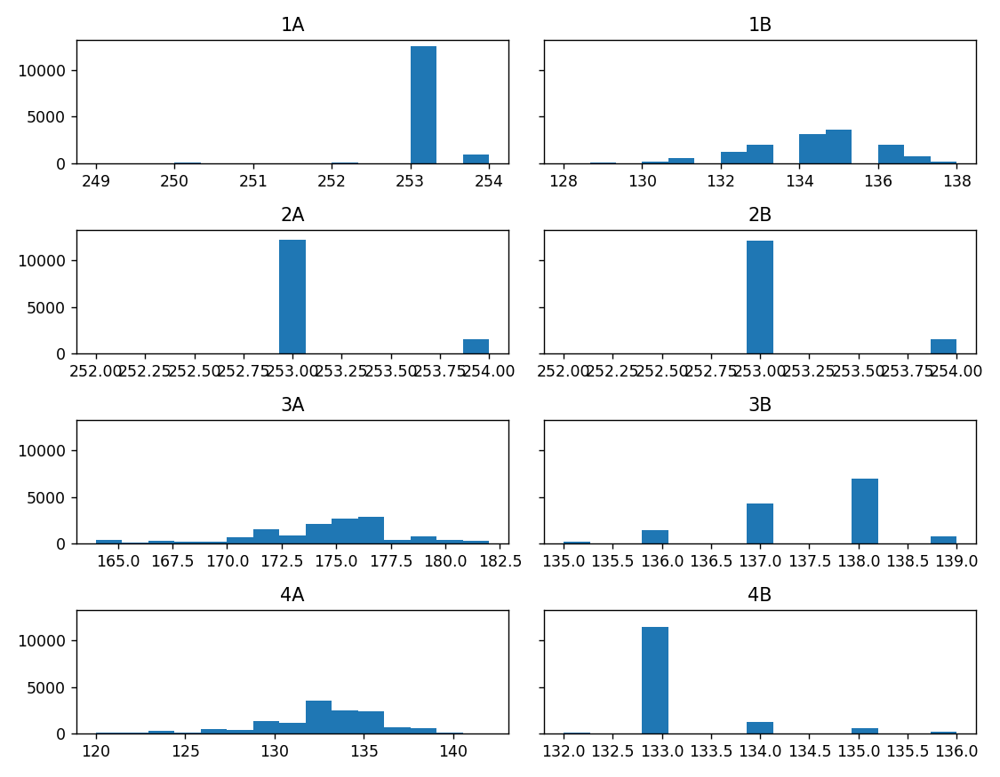

In [44]:
# Histogram of strain gauges 1-4 A & B
fig0, axs0 = plt.subplots(4, 2, sharey=True, tight_layout=True,figsize=(9, 7))
axs0[0,0].hist(df['1A'], bins=15)
axs0[0,0].set_title('1A')
axs0[0,1].hist(df['1B'], bins=15)
axs0[0,1].set_title('1B')
axs0[1,0].hist(df['2A'], bins=15)
axs0[1,0].set_title('2A')
axs0[1,1].hist(df['2B'], bins=15)
axs0[1,1].set_title('2B')
axs0[2,0].hist(df['3A'], bins=15)
axs0[2,0].set_title('3A')
axs0[2,1].hist(df['3B'], bins=15)
axs0[2,1].set_title('3B')
axs0[3,0].hist(df['4A'], bins=15)
axs0[3,0].set_title('4A')
axs0[3,1].hist(df['4B'], bins=15)
axs0[3,1].set_title('4B')
plt.show()

In [45]:
base_start =  df[['1A','1B','2A','2B','3A','3B','4A','4B']].iloc[1:1000].mean()
base_end = df[['1A','1B','2A','2B','3A','3B','4A','4B']].iloc[(len(df)-1000):].mean()
base_diff = base_start - base_end
print(base_start,base_end)
# Convert strain gauge base value to the real resistance value to compare with nominal values of 
R_0 = 350 # nominal resistance R_0 = 350 Ohm
G = 49.8 # gain
N0 = 255 # 8-bit ADC (0-255 = 256 values)
#R_base_start = pd.DataFrame() 
#R_base_end = pd.DataFrame() 
R_base_start = {}
R_base_end = {}

for i in range(len(base_start)):
    R_base_start[i] = R_0*((0.5+((base_start.iloc[i]-(N0/2))/(N0*G)))/(1-(0.5+(base_start.iloc[i]-(N0/2))/(N0*G))))
    R_base_end[i] = R_0*((0.5+((base_end.iloc[i]-(N0/2))/(N0*G)))/(1-(0.5+(base_end.iloc[i]-(N0/2))/(N0*G))))
#print(pd.Series(R_base_start))
#print(pd.Series(R_base_end))

1A    253.043043
1B    135.253253
2A    253.114114
2B    253.097097
3A    172.440440
3B    137.067067
4A    131.064064
4B    133.073073
dtype: float64 1A    253.030
1B    134.798
2A    253.112
2B    253.123
3A    175.981
3B    138.000
4A    134.010
4B    132.993
dtype: float64


In [46]:
# Plots for raw strain gauge values

df.iplot(x='t',y=['1A','1B'],title="1A & 1B")
df.iplot(x='t',y=['2A','2B'],title="2A & 2B")
df.iplot(x='t',y=['3A','3B'],title="3A & 3B")
df.iplot(x='t',y=['4A','4B'],title="4A & 4B")


# Smoothing strain gauge signal

Using a Savitzky–Golay filter

In [47]:
df_filt=pd.DataFrame()
df_filt['1A'] = scipy.signal.savgol_filter(df['1A'], 51, 3)
df_filt['1B'] = scipy.signal.savgol_filter(df['1B'], 51, 3)
df_filt['2A'] = scipy.signal.savgol_filter(df['2A'], 51, 3)
df_filt['2B'] = scipy.signal.savgol_filter(df['2B'], 51, 3)
df_filt['3A'] = scipy.signal.savgol_filter(df['3A'], 51, 3)
df_filt['3B'] = scipy.signal.savgol_filter(df['3B'], 51, 3)
df_filt['4A'] = scipy.signal.savgol_filter(df['4A'], 51, 3)
df_filt['4B'] = scipy.signal.savgol_filter(df['4B'], 51, 3)
df_new=pd.concat([df_t, df_filt['1A'],df_filt['1B'],df_filt['2A'],df_filt['2B'],df_filt['3A'],df_filt['3B'],df_filt['4A'],df_filt['4B']], axis=1)
col_names=['t','1A','1B','2A','2B','3A','3B','4A','4B']
df_new.columns=col_names
# Plots for raw strain gauge values
df_new.iplot(x='t',y=['1A','1B'],title="1A & 1B")
df_new.iplot(x='t',y=['2A','2B'],title="2A & 2B")
df_new.iplot(x='t',y=['3A','3B'],title="3A & 3B")
df_new.iplot(x='t',y=['4A','4B'],title="4A & 4B")

# Convert to resistance value

In [31]:
# Convert strain gauge value N to the real resistance value Rx
R_0 = 350 # nominal resistance R_0 = 350 Ohm -> replace with respective base start value
G = 49.8 # gain
N0 = 255 # 8-bit ADC (0-255 = 256 values)
N = df[['1A','1B','2A','2B','3A','3B','4A','4B']]# test col 1A for N
Rx = pd.DataFrame() # initalize empty DataFrame for real resistance values

# Loop in to fill Rx DataFrame
for i in range(len(N)):
    for j in range(len(N.columns)):
        Rx.loc[i,j] = R_0*((0.5+((N.iloc[i,j]-(N0/2))/(N0*G)))/(1-(0.5+(N.iloc[i,j]-(N0/2))/(N0*G))))
Rx.columns = ['1A','1B','2A','2B','3A','3B','4A','4B'] # rename columns of Rx 

# Calculation of strain eps in [%] -> max. elongation/compression of strain gauge +/-3%
eps = pd.DataFrame() # initalize empty DataFrame for epsilon

for i in range(len(Rx)):
    for j in range(len(Rx.columns)):
        eps.loc[i,j] = (abs(R_0-Rx.iloc[i,j]))/R_0
eps.columns = ['1A','1B','2A','2B','3A','3B','4A','4B'] # rename columns of eps

print(max(eps['1A']),max(eps['1B']),max(eps['2A']),max(eps['2B']),max(eps['3A']),max(eps['3B']),max(eps['4A']),max(eps['4B']))

             1A        1B        2A        2B        3A        3B        4A  \
0      0.023423  0.000787  0.040328  0.024390  0.001103  0.002997  0.003302   
1      0.023423  0.000787  0.040328  0.024390  0.001103  0.002997  0.002674   
2      0.023423  0.000787  0.040000  0.024390  0.001103  0.002997  0.002988   
3      0.023423  0.000787  0.040328  0.024390  0.001103  0.002681  0.002360   
4      0.023423  0.000787  0.040328  0.024390  0.001103  0.002997  0.003302   
...         ...       ...       ...       ...       ...       ...       ...   
13104  0.023745  0.000157  0.040328  0.009018  0.001418  0.002997  0.002988   
13105  0.023423  0.000157  0.040328  0.009018  0.001734  0.002997  0.002045   
13106  0.023745  0.000157  0.040328  0.009018  0.001734  0.002997  0.002674   
13107  0.023423  0.000157  0.040328  0.009018  0.001734  0.002997  0.002674   
13108  0.023423  0.000157  0.040328  0.009018  0.001418  0.002997  0.002988   

             4B  
0      0.001103  
1      0.001103

# Temperature

In [32]:
# Plot of temperature curve
df_temp = pd.concat([df_t, df['Temp']], axis=1)
col_temp = ['t','Temp']
df_temp.columns = col_temp
df_temp.iplot(x='t', y='Temp')